In [42]:
import sys
sys.path.append('/home/tpopova/prj/PB_SCF/charge_surface/py_files')
from flatQuenchedBrush import flatQuenchedBrush
from create_in import create_in
from h_scf import h_scf

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np


In [43]:
N = 200

S_namics = 150

S = 150

alpha = 0.5

valence_values = np.linspace(0, 0.35, num = 20)
Cs_values = np.linspace(0.0005, 0.01, num = 20)

chi = 0.5
chi_surf = -0.3

In [44]:
# Матрицы для хранения значений графика
X = []  # Для значений valence
Y = []  # Для значений Cs
Z = []  # Для толщины щетки

In [45]:
for surf_val in valence_values:
    for Cs in Cs_values:
        # Создание SCF файла с текущими значениями
        file_name_pro = create_in(
            template_surf_charge='/home/tpopova/prj/PB_SCF/charge_surface/scf_templates/flat_brush_surf.in',
            range_param='Cs',
            min_val=0.1,
            max_val=0.1,
            Cs=Cs,
            chi=chi,
            chi_surf=chi_surf,
            N_layers=N,
            N=N,
            S=S_namics,
            alpha=alpha,
            surf_val=surf_val
        )
        
        # Получение результатов расчёта для текущих значений
        H_q, z_in_range_q, z_out_range_q, c_p, y_in, y_out, y_exp_in, y_exp_out, y_exp_q_in, y_exp_q_out, \
        f_ion_SCF_quen, Q_SCF_quen, parse_SCF_psi_quen, parse_SCF_phi_quen = flatQuenchedBrush(
            N=N,
            S=S,
            alpha=alpha,
            Cs=Cs,
            file_names=file_name_pro
        )
        
        # Рассчитываем толщину щетки с помощью функции h_scf
        brush_thickness = h_scf(parse_SCF_phi_quen)
        
        # Сохраняем значения для графика
        X.append(surf_val)  # valence
        Y.append(Cs)        # Cs
        Z.append(brush_thickness)  # Толщина щетки



Problem nr 1 out of 1
The program is compiled for the use of 'long double' while 'overflow_protection' is not requested for;
1. Turn on 'overflow_protection'.
2. Compile progrem without the #define 'LongReal' in namics.h. 
NEWTON has been notified.
Your guess:it =  0  E = 1.965686e+00 |g| = 4.688118e+00 alpha = 1.000000e+00 
hessian scaling: 0.836176
it =  1  E = 1.793913e+00 |g| = 4.295021e+00 alpha = 1.213305e-01 
it =  2  E = 2.806538e+00 |g| = 4.729877e+00 alpha = 5.130010e-02 
it =  3  E = 9.149123e+00 |g| = 5.012233e+00 alpha = 5.493346e-03 
it =  4  E = 1.283172e+01 |g| = 4.846853e+00 alpha = 2.786208e-03 
it =  5  E = 6.970590e+00 |g| = 4.825816e+00 alpha = 8.996453e-03 
it =  6  E = 8.838970e+00 |g| = 4.829733e+00 alpha = 5.255125e-03 
it =  7  E = 7.743639e+00 |g| = 4.703868e+00 alpha = 6.213437e-03 
it =  8  E = 1.302320e+01 |g| = 4.657023e+00 alpha = 2.357337e-03 
it =  9  E = 8.588153e+00 |g| = 4.629233e+00 alpha = 4.982290e-03 
it =  10  E = 1.096941e+01 |g| = 4.605996e+0

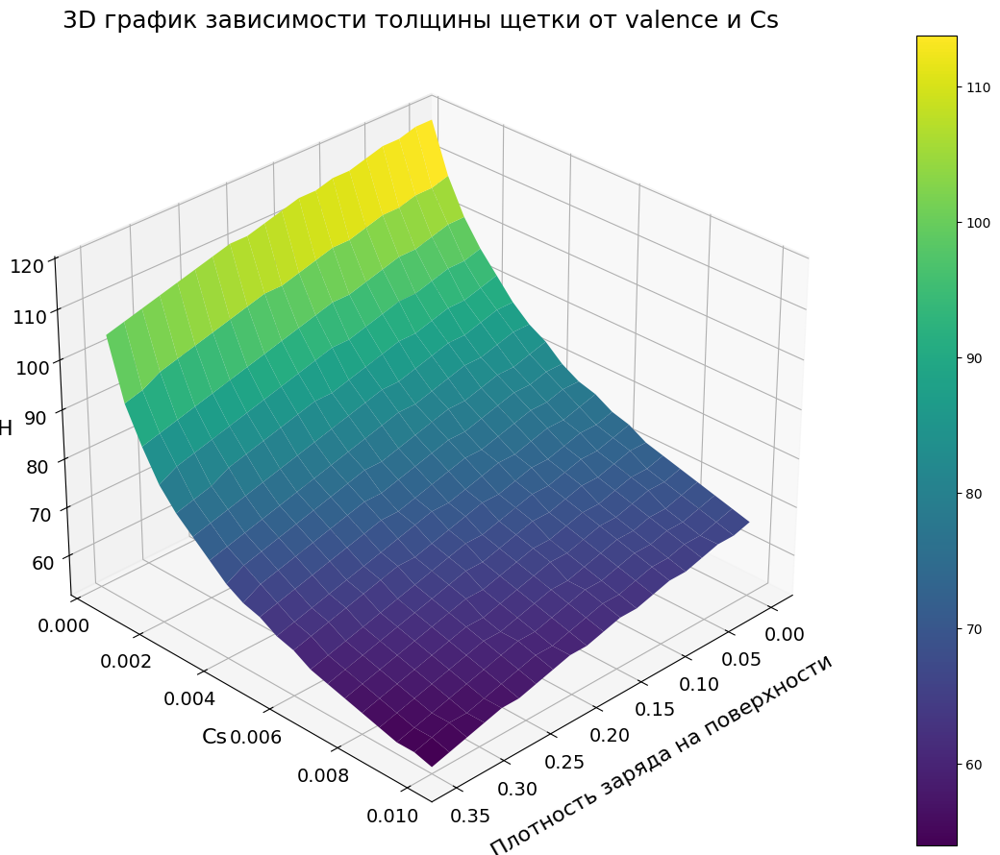

In [59]:
# Преобразование данных в формат numpy массивов для удобства
X = np.array(X)
Y = np.array(Y)
Z = np.array(Z)

# Перестроение X и Y в сетку для 3D графика
X_grid, Y_grid = np.meshgrid(np.unique(X), np.unique(Y))
Z_grid = np.zeros_like(X_grid, dtype=float)

# Заполнение Z_grid значениями Z для каждого сочетания X и Y
for i in range(len(X)):
    x_idx = np.where(np.unique(X) == X[i])[0][0]
    y_idx = np.where(np.unique(Y) == Y[i])[0][0]
    
    # Записываем значение толщины щетки в Z_grid
    Z_grid[y_idx, x_idx] = Z[i]

# Создание 3D графика
fig = plt.figure(figsize=(19, 9))
ax = fig.add_subplot(111, projection='3d')

# Построение поверхности
surf = ax.plot_surface(X_grid, Y_grid, Z_grid, cmap='viridis', edgecolor='none')

# Настройка графика
ax.set_xlabel('Плотность заряда на поверхности', fontsize=16, labelpad=15)
ax.set_ylabel('Cs', fontsize=16)
ax.set_zlabel('H', fontsize=16)
ax.set_title('3D график зависимости толщины щетки от valence и Cs', fontsize=18)

# Увеличение размера цифр на осях
ax.tick_params(axis='both', which='major', labelsize=14)  # Увеличиваем размер цифр на осях

plt.tight_layout()

# Добавление цветовой шкалы
fig.colorbar(surf)

# Настройка вида графика
ax.view_init(elev=30, azim=45)

# Показ графика
plt.savefig('Fig_1.pdf', dpi=300, bbox_inches='tight')
plt.show()